# Phase plane analysis (and more)

Re-write (re-organize) the previous code:

In [2]:
using Catalyst, Plots, StochasticDiffEq, DiffEqJump, Latexify
using DifferentialEquations
using Random
using Statistics

#Random.seed!(7777)

In [3]:
"duo-input Hill function. X and Y are the
activational and repressional inputs respectively"
duo_input_hill(X, Y, S, D, n) = 
    (S * X)^n / ((S * X)^n + (D * Y)^n + 1)

"Generate the general sigma factor model reactions"
function reaction_system(; _δ = 1)
    # model definition
    sigma_model = @reaction_network begin
        1/τ₁ * β * v₀, ∅ --> σ
        1/τ₁ * β * duo_input_hill(σ, A, S, D, n), ∅ --> σ
        1/τ₁, σ --> ∅
        1/τ₂ * σ, ∅ --> A
        1/τ₂, A --> ∅
    end v₀ β S D n τ₁ τ₂ η    # η is for SDE only
    
    # if δ is specified, change the step size
    if(_δ > 1)
        # modify the stoich of σ prod
        @parameters t β S D n τ₁
        @variables σ(t) A(t)
        ## the A prod eqn
        sigma_model.eqs[2] = 
            Reaction(1/τ₁ * β * duo_input_hill(σ, A, S, D, n), nothing, [σ], nothing, [_δ])
        println("burst size δ = ", _δ)
    end
    
    return sigma_model
end

reaction_system

In [109]:
function interpret_sol(sol)
    t_vec = sol.t
    σ_vec = [sol.u[i][1] for i in 1:length(t_vec)]
    A_vec = [sol.u[i][2] for i in 1:length(t_vec)]
    
    return t_vec, σ_vec, A_vec
end

"plot time course of the simulation"
function plot_timecourse(sol, stress_t; show_vars = [1, 2])
    plt = plot(sol,
        vars = show_vars,
        ylabel = "# molecules",
        title = "Time course",
        alpha = 0.7)
    plot!(plt, [stress_t], seriestype = "vline", color = "red", 
        linestyle = :dash, labels = "Adding stress")
    return plt
end

# TODO: do we want to normalize σ and A?
"plot phase plane"
function plot_phase_plane(sol)
    ~, σ_vec, A_vec = interpret_sol(sol)
    
    # phase plane plot
    plt = plot(σ_vec, A_vec, labels = "phase plane", legend = :topleft)
    plot!(plt, σ_vec, A_vec, seriestype = :scatter,
        markerstrokewidth = 0, alpha = 0.2, color = "black")
    plot!(plt, [0, maximum(A_vec)], [0, maximum(A_vec)], 
        color = "red", linestyle =:dash, 
        labels = "y = x", title = "Phase Plane",
        xlabel = "σ", ylabel = "A")
#     plot!(pp_plot, _S / _D * [0, maximum(A_vec)], [0, maximum(A_vec)], 
#         color = "green", linestyle =:dash, labels = "Hill ≈ 0.5")
    return plt
end

"plot the hill function value"
function plot_hill(sol, _S, _D, _n)
    t_vec, σ_vec, A_vec = interpret_sol(sol)
    
    hill_vec = [duo_input_hill(x, y, _S, _D, _n) for (x, y) = zip(σ_vec, A_vec)]
    plt = plot(t_vec, hill_vec, title = "Hill function", legend = false)
    
    return plt
end

plot_hill

In [102]:
"""
Simulate entrance

method: choose solver, available methods are "ssa" (Gillespie), "ode" and "sde"
parameters: including _v₀, _β, _KS, _rK (i.e. KD/KS), _n, _τ₁, _rτ (i.e. τ₂/τ₁), _η
max_t: maximum time span, default 2000.
stress_t: the time point that adds stress, default 200.
show_tc: show timecourse plot, default true
show_pp: show phase plane plot, default true
show_hill: show hill func. plot, default true
"""
function simu_all(_m; _v₀ = 0.01, _β = 100., _KS = 0.2, _rK = 1.,
        _n = 3., _τ₁ = 10., _rτ = 1., _η = .1, 
        max_t = 2000., stress_t = 200., method = "ssa",
        show_tc = true, show_pp = true, show_hill = true)
    tspan = (0., max_t)    # time course
    u₀ = [0, 0]  # initial state, σ A

    # parameters, v₀ β S D n τ₁ τ₂ η
    # S is initially set to 0 and subject to a step change
    p = [_v₀, _β, 1 / _KS, 1 / (_rK * _KS), _n, _τ₁, _τ₁ * _rτ, _η]
    
    # choose different methods
    if method == "ssa"
        sol = simu_ssa(_m, tspan, u₀, p, stress_t)
    elseif method == "ode"
        sol = simu_ode(_m, tspan, u₀, p, stress_t)
    elseif method == "sde"
        sol = simu_sde(_m, tspan, u₀, p, stress_t)
    else
        println("Simulation method $method not found. Abort.")
        return nothing
    end
    
    # print parameters
    # TODO
    println("KD/KS = ", _rK, "; KS = ", _KS, "; τ₂/τ₁ = ", _rτ,
        "; β= ", _β, "; n = ", _n)
    
    # plot
    if show_tc
        display(plot_timecourse(sol, stress_t))    # time course
    end
    if show_pp
        display(plot_phase_plane(sol))    # phase plane
    end
    if show_hill
        display(plot_hill(sol, 1 / _KS, 1 / (_rK * _KS), _n))
    end
    
    # return arrays
    return interpret_sol(sol)
end

"Call back to add stress"
function S_step(step_time, step_value)
    # in solve, must use tstops to specify the break point
    condition(u, t, integrator) = (t == step_time)
    affect!(integrator) = integrator.p[3] += step_value    # S
    return DiscreteCallback(condition, affect!, save_positions = (true,true))
end

"simulate with Gillespie"
function simu_ssa(_m, tspan, u₀, p, stress_t; _saveat = 1.)
    _S = p[3]    # save S value
    p[3] = 0.    # initially set S = 0
    
    # Gillespie
    dprob = DiscreteProblem(_m, u₀, tspan, p)
    jprob = JumpProblem(_m, dprob, Direct(), save_positions = (false, false))
    jsol = solve(jprob, SSAStepper(),
        callback = S_step(stress_t, _S),
        tstops = [stress_t],
        saveat = _saveat)
    return jsol
end

"Simulate with ODE"
function simu_ode(_m, tspan, u₀, p, stress_t; _saveat = 1.)
    _S = p[3]    # save S value
    p[3] = 0.    # initially set S = 0
    
    oprob = ODEProblem(_m, u₀, tspan, p)
    sol = solve(oprob, Tsit5(), saveat = _saveat,
        callback = S_step(stress_t, _S),
        tstops = [stress_t])
    
    return sol
end

"Simulate with SDE"
function simu_sde()
    return nothing
end

simu_sde

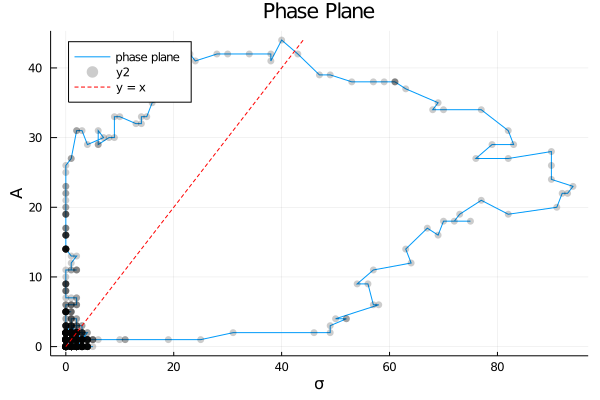

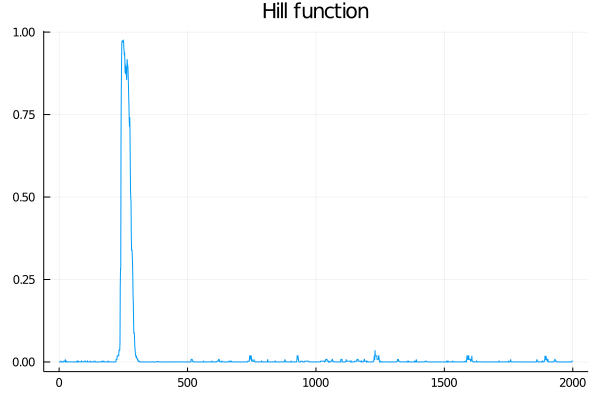

KD/KS = 0.5; KS = 15.0; τ₂/τ₁ = 5.0; β= 100.0; n = 3.0


In [110]:
sigma_model = reaction_system()

_KS = 15.0
_rK = 0.5
_β = 100.
_τ₁ = 10.
_rτ = 5.
_n = 3.

t, σ, A = simu_all(sigma_model, _KS = _KS, _rK = _rK, _β = _β, _τ₁ = _τ₁, _rτ = _rτ, _n = _n);

#t, σ, A = simu_all(sigma_model, method = "ode", _KS = _KS, _rK = _rK, _β = _β, _τ₁ = _τ₁, _rτ = _rτ, _n = _n);

Reproduce all of the typical behaviours, including a) no expression, b) stochastic pulsing, c) oscillation, d) stochastic anti-pulsing, e) stochastic switching, f) single-pusling, g) het. activation and h) homo. activation

no expression

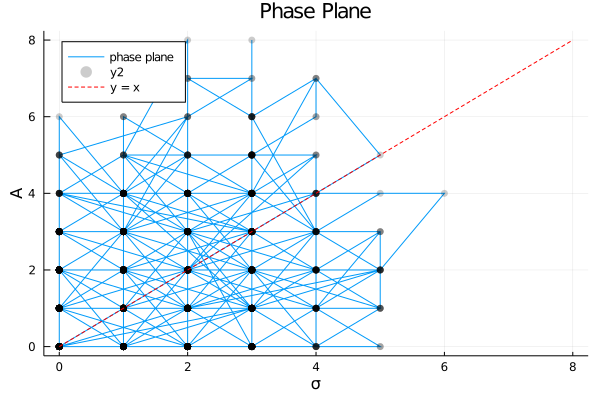

KD/KS = 0.01; KS = 100.0; τ₂/τ₁ = 1.0; β= 100.0; n = 3.0
stochastic pulsing

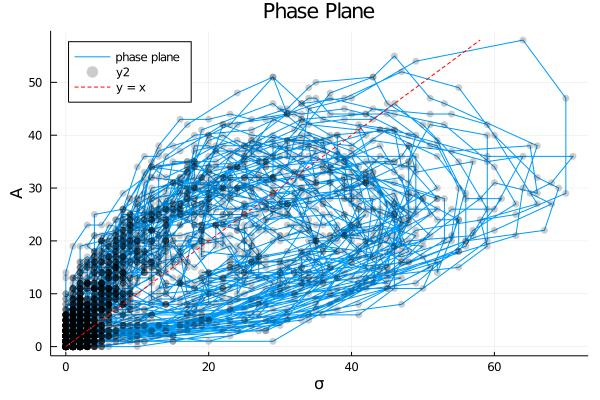

KD/KS = 0.5; KS = 10.0; τ₂/τ₁ = 1.0; β= 100.0; n = 3.0
oscillation

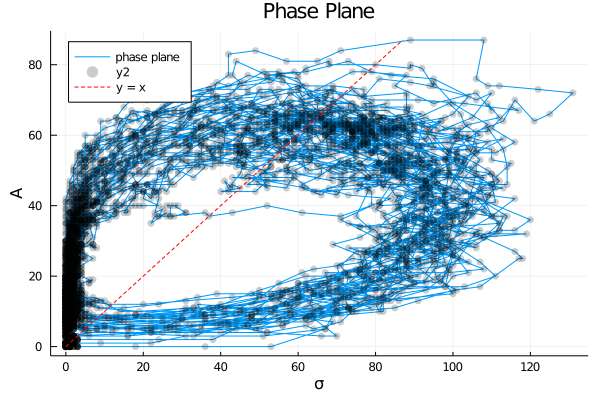

KD/KS = 1.0; KS = 0.1; τ₂/τ₁ = 5.0; β= 100.0; n = 3.0
stochastic anti-pulsing

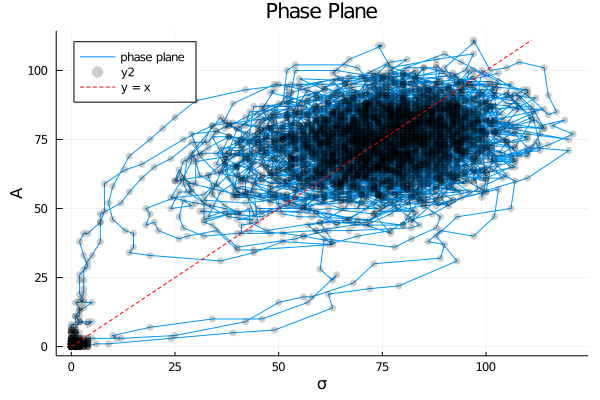

KD/KS = 1.45; KS = 10.0; τ₂/τ₁ = 2.0; β= 100.0; n = 3.0
stochastic switching

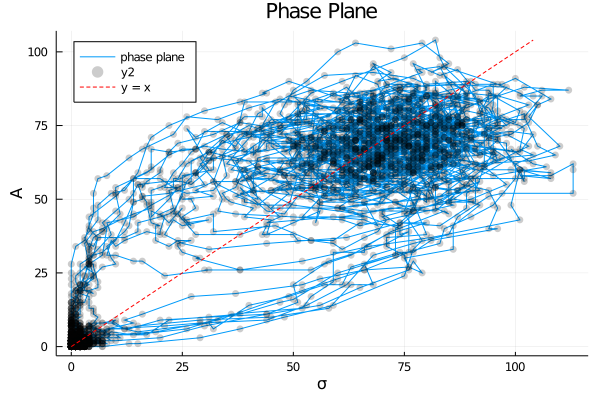

KD/KS = 1.3; KS = 15.0; τ₂/τ₁ = 2.0; β= 100.0; n = 3.0
single pulsing

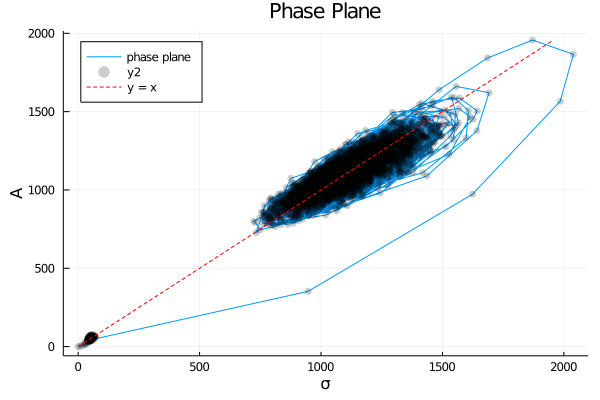

KD/KS = 0.8; KS = 10.0; τ₂/τ₁ = 0.2; β= 5000.0; n = 6.0
het. activaiton

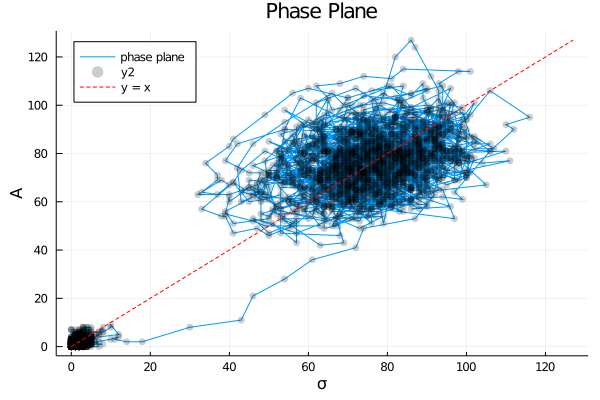

KD/KS = 1.5; KS = 20.0; τ₂/τ₁ = 1.0; β= 100.0; n = 3.0
homo. activation

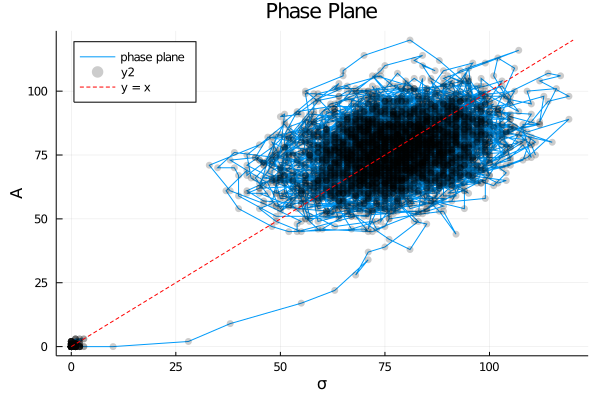


KD/KS = 1.5; KS = 0.1; τ₂/τ₁ = 1.0; β= 100.0; n = 3.0


In [117]:
timescale = 5.0
timecourse = 5e3

# no expression, rK is small (repressional forse is strong) and KS is large
print("no expression")
simu_all(sigma_model, _KS = 100.0, _rK = 0.01, _β = 100.0, _τ₁ = timescale, _rτ = 1.0, _n = 3.0, 
    show_hill = false, max_t = timecourse);

# stochastic pulsing, rK is relative small (but not too small so that expression
# is entirely repressed) and KS is large
print("stochastic pulsing")
simu_all(sigma_model, _KS = 10.0, _rK = 0.5, _β = 100.0, _τ₁ = timescale, _rτ = 1.0, _n = 3.0, 
    show_hill = false, max_t = timecourse);

# oscillation, rK is relative small, KS is small (so that the ensueing pulsing is immediate)
# rτ > 1 (significant delay)
print("oscillation")
simu_all(sigma_model, _KS = 0.1, _rK = 1.0, _β = 100.0, _τ₁ = timescale, _rτ = 5.0, _n = 3.0, 
    show_hill = false, max_t = timecourse);

# stochastic anti-pulsing, very difficult to achieve
# happens in a specific rK value and rτ > 1
print("stochastic anti-pulsing")
simu_all(sigma_model, _KS = 10.0, _rK = 1.45, _β = 100.0, _τ₁ = timescale, _rτ = 2.0, _n = 3.0, 
    show_hill = false, max_t = timecourse);

# stochastic switching, similar to stochastic anti-pusling, but in smaller rK
print("stochastic switching")
simu_all(sigma_model, _KS = 15.0, _rK = 1.3, _β = 100.0, _τ₁ = timescale, _rτ = 2.0, _n = 3.0, 
    show_hill = false, max_t = timecourse);

# single pulsing, rare behaviour, only happens at large β
print("single pulsing")
simu_all(sigma_model, _KS = 10.0, _rK = 0.8, _β = 5000.0, _τ₁ = timescale, _rτ = 0.2, _n = 6.0, 
    show_hill = false, max_t = timecourse);

# heterogeneous activation, occurs in large KS and large rK
print("het. activaiton")
simu_all(sigma_model, _KS = 20.0, _rK = 1.5, _β = 100.0, _τ₁ = timescale, _rτ = 1.0, _n = 3.0, 
    show_hill = false, max_t = timecourse);

# homogeneous activation, small KS and large rK
println("homo. activation")
simu_all(sigma_model, _KS = 0.1, _rK = 1.5, _β = 100.0, _τ₁ = timescale, _rτ = 1.0, _n = 3.0, 
    show_hill = false, max_t = timecourse);